In [4]:
!unzip /content/drive/MyDrive/CV/data_semantics.zip

Archive:  /content/drive/MyDrive/CV/data_semantics.zip
   creating: data_semantics/
  inflating: __MACOSX/._data_semantics  
  inflating: data_semantics/.DS_Store  
  inflating: __MACOSX/data_semantics/._.DS_Store  
   creating: data_semantics/training/
  inflating: __MACOSX/data_semantics/._training  
   creating: data_semantics/testing/
  inflating: __MACOSX/data_semantics/._testing  
  inflating: data_semantics/training/.DS_Store  
  inflating: __MACOSX/data_semantics/training/._.DS_Store  
   creating: data_semantics/training/image_2/
  inflating: __MACOSX/data_semantics/training/._image_2  
   creating: data_semantics/training/instance/
  inflating: __MACOSX/data_semantics/training/._instance  
   creating: data_semantics/training/semantic/
  inflating: __MACOSX/data_semantics/training/._semantic  
   creating: data_semantics/training/semantic_rgb/
  inflating: __MACOSX/data_semantics/training/._semantic_rgb  
   creating: data_semantics/testing/image_2/
  inflating: __MACOSX/data

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.activity.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fexperimentsandconfigs%20https%3a%2f%2fwww.googleapis.com%2fauth%2fphotos.native&response_type=code

Enter your authorization code:
4/1AX4XfWhJoERUpdWRYH80RkM4YXffO3xivlKEdlBhPdlqJwGCAYalXVLu8Jc
Mounted at /content/drive


In [ ]:
#!unzip /content/drive/MyDrive/CV/devkit_semantics.zip

In [85]:
import torchvision.models as models
import torch.nn as nn
import torch
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader
resnet18 = models.resnet18(pretrained=True)
from torchvision import transforms as T
from torchvision.transforms import ToTensor, ToPILImage, PILToTensor, Normalize, Compose, Resize, RandomHorizontalFlip
import torch.nn.functional as F
from torch.optim.lr_scheduler import StepLR
#resnet18
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()
from tqdm import tqdm
from torchsummary import summary
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score 
from sklearn.metrics import classification_report 
from sklearn.metrics import roc_curve, auc # roc curve tools 
import warnings
import pandas as pd
warnings.filterwarnings('ignore')
import seaborn as sns
from collections import namedtuple
from torchvision.models._utils import IntermediateLayerGetter


In [6]:
# Get cpu or gpu device for training.
device = "cuda" if torch.cuda.is_available() else "cpu"
if device == "cpu":
    print("Using {} enabled device".format(device))
else:
    print("Using {} enabled device : {}".format(device, torch.cuda.get_device_name(0)))
torch.backends.cudnn.benchmark = True

Using cuda enabled device : Tesla K80


In [7]:
n_classes = 34

In [8]:
def crop(o, x):
    cx = int((o.shape[3] - x.shape[3]) / 2)
    cy = int((o.shape[2] - x.shape[2]) / 2)
    o = o[:, :, cy:cy + x.shape[2], cx:cx + x.shape[3]]
    return o

In [9]:
class FCN32(nn.Module):
    def __init__(self, model):
        super(FCN32, self).__init__()
        self.resnet18 = model
        self.resnet18.conv1.padding = (100, 100)
        self.resnet18.avgpool = nn.AvgPool2d(7, stride=1)  
        self.resnet18 = nn.Sequential(*(list(resnet18.children())[0:-1]))
        for param in resnet18.parameters():
            param.requires_grad = False
        self.conv2d = nn.Conv2d(512, n_classes, 1, stride=1)      # 34+1 output classes input layer 
        self.conv2dTrans = nn.ConvTranspose2d(n_classes, n_classes, 64, stride=32) #

    def forward(self, x):
        o = x
        o = self.resnet18(o)
        o = F.relu(self.conv2d(o))
        o = self.conv2dTrans(o)
        cx = int((o.shape[3] - x.shape[3]) / 2)
        cy = int((o.shape[2] - x.shape[2]) / 2)
        o = o[:, :, cy:cy + x.shape[2], cx:cx + x.shape[3]]
        return o

resnet18 = models.resnet18(pretrained=True)
model_FCN32 = FCN32(resnet18)
model_FCN32 = model_FCN32.to(device)
summary(model_FCN32,(3,376, 1241),batch_size = 1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 64, 285, 718]           9,408
       BatchNorm2d-2          [1, 64, 285, 718]             128
              ReLU-3          [1, 64, 285, 718]               0
         MaxPool2d-4          [1, 64, 143, 359]               0
            Conv2d-5          [1, 64, 143, 359]          36,864
       BatchNorm2d-6          [1, 64, 143, 359]             128
              ReLU-7          [1, 64, 143, 359]               0
            Conv2d-8          [1, 64, 143, 359]          36,864
       BatchNorm2d-9          [1, 64, 143, 359]             128
             ReLU-10          [1, 64, 143, 359]               0
       BasicBlock-11          [1, 64, 143, 359]               0
           Conv2d-12          [1, 64, 143, 359]          36,864
      BatchNorm2d-13          [1, 64, 143, 359]             128
             ReLU-14          [1, 64, 1

In [87]:
class FCN16(nn.Module):
    def __init__(self, pretrained_model):
        super(FCN16, self).__init__()
        self.ckpt_path = './checkpoint/fcn16_ckpt.pth'
        self.start_epoch = 0
        self.best_acc = 0
        
        self.pretrained_model = pretrained_model
        self.resnet_mod = IntermediateLayerGetter(self.pretrained_model, 
                                                  {'layer3':'out_layer3', 'layer4':'out_layer4'})
        self.avg_pool = nn.AvgPool2d(kernel_size=7, stride=1)
        self.score_pool = nn.Conv2d(512, n_classes, kernel_size=1, stride=1)
        self.score_conv4 = nn.Conv2d(256, n_classes, kernel_size=1, stride=1)
        
        self.upscore2 = nn.ConvTranspose2d(n_classes, n_classes, kernel_size=4, stride=2)
        self.upscore16 = nn.ConvTranspose2d(n_classes, n_classes, kernel_size=32, stride=16)
        
        self.relu = nn.ReLU(inplace=True)

    def _crop(self, o, x):
        cx = int((o.shape[3] - x.shape[3]) / 2)
        cy = int((o.shape[2] - x.shape[2]) / 2)
        o = o[:, :, cy:cy + x.shape[2], cx:cx + x.shape[3]]
        return o
            
    def forward(self, x):
        o = x
        inter_out = self.resnet_mod(o)
        o_conv4 = inter_out['out_layer3']
        o_conv5 = inter_out['out_layer4']
        
        o_avgpool = self.avg_pool(o_conv5)
        o_score_pool = self.relu(self.score_pool(o_avgpool))
        o_upscore2 = self.upscore2(o_score_pool)
        
        o_score_conv4 = self.relu(self.score_conv4(o_conv4))
        o_score_conv4 = self._crop(o_score_conv4, o_upscore2)
        
        o_score = o_upscore2 + o_score_conv4
        
        o_upscore16 = self.upscore16(o_score)
        o = self._crop(o_upscore16, x)
        
        return o

resnet18_pretrained = models.resnet18(pretrained=True)
resnet18_pretrained.conv1.padding = (100, 100)
model_FCN16 = FCN16(resnet18_pretrained)
model_FCN16 = model_FCN16.to(device)

x = torch.randn(5, 3, 376, 1242).to(device)
out = model_FCN16(x)
print(out.shape)
#summary(model_FCN16,(3,376, 1241),batch_size = 1)
    


torch.Size([5, 34, 376, 1242])


In [11]:
IMAGE_PATH = '/content/data_semantics/training/image_2/'
MASK_PATH = '/content/data_semantics/training/semantic/'

In [12]:
def create_df():
    name = []
    for dirname, _, filenames in os.walk(IMAGE_PATH):
        for filename in filenames:
            name.append(filename.split('.')[0])
    
    return pd.DataFrame({'id': name}, index = np.arange(0, len(name)))

df = create_df()
df = df.sort_values(by=['id'])
print('Total Images: ', len(df))

Total Images:  200


In [13]:
#split data
X_trainval, X_test = train_test_split(df['id'].values, test_size=0.15, shuffle=False)
X_train, X_val = train_test_split(X_trainval, test_size=0.1764, shuffle=False)

print('Train Size   : ', len(X_train))
print('Val Size     : ', len(X_val))
print('Test Size    : ', len(X_test))

Train Size   :  140
Val Size     :  30
Test Size    :  30


### Dataset class

In [14]:
class kittiDataset(Dataset):
    
    def __init__(self, img_path, mask_path, X,mean=None,std=None):
        self.img_path = img_path
        self.mask_path = mask_path
        self.mean = mean
        self.std = std
        self.X = X
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        img = cv2.imread(self.img_path + self.X[idx] + '.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)                   ## check if this is required ??
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE) 
        img = Image.fromarray(img)
        t = T.Compose([T.ToTensor()])#,Normalize(self.mean, self.std)])  ## do we need to normalize the data this time ??
        img = t(img)
        mask = torch.from_numpy(mask).long()
   
        return img, mask

### Loading all Datasets

In [16]:
#mean=[0.485, 0.456, 0.406]
#std=[0.229, 0.224, 0.225]
#datasets
train_set = kittiDataset(IMAGE_PATH, MASK_PATH, X_train, mean,std)
val_set = kittiDataset(IMAGE_PATH, MASK_PATH, X_val,mean,std)
test_set = kittiDataset(IMAGE_PATH, MASK_PATH, X_test,mean, std)

#dataloader
batch_size= 1 

train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True) 
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=True) 


### Train function

In [17]:
def train(model, epochs, criterion, optimizer, scheduler,model_name=""):
    model.train()
    min_valid_loss = float("inf")
    
    for epoch in range(1,epochs+1):  # loop over the dataset multiple times
        running_loss = 0.0
        running_accuracy = 0
        
        for i, data in tqdm(enumerate(train_loader, 0)):
            batch_loss = 0
            batch_accuracy = 0
            
            
            inputs, labels = data    # get the inputs; data is a list of [inputs, labels]
            inputs,labels = inputs.to(device), labels.to(device)
            
            optimizer.zero_grad()    # zero the parameter gradients

            
            outputs = model(inputs)  # forward + backward + optimize
            loss = criterion(outputs, labels) # calculate loss
            loss.backward()                   # accumulate gradient
            optimizer.step()                  # update weights

            # add statistics calculated
            running_loss += loss.item()
            #running_accuracy += multi_accuracy(outputs,labels)
            batch_loss += loss.item()
            #batch_accuracy += multi_accuracy(outputs,labels)
            
            # log statistics on tensorboard
            writer.add_scalars(model_name+' batch_step_loss', {'training loss':(batch_loss/len(data))}, epoch)
            #writer.add_scalars(model_name+' batch_step_accuracy', {'training accuracy':(batch_accuracy/len(data))}, epoch)
        
        # advance the scheduler for lr decay
        scheduler.step()
        
        
        # calculate loss and accuracy on validation set
        r_valid_loss = 0.0
        r_valid_accuracy = 0
        model.eval()
        for data, labels in val_loader:
            data,labels = data.to(device), labels.to(device)
            target = model(data)
            loss = criterion(target,labels)
            r_valid_loss += loss.item() 
            #r_valid_accuracy += multi_accuracy(target, labels) 
        valid_loss_avg =  r_valid_loss/len(val_loader)
        if valid_loss_avg < min_valid_loss :
            torch.save(model.state_dict(), '/content/drive/MyDrive/CV/saved_models/'+model_name+'.pt')
            min_valid_loss = valid_loss_avg

        print("epoch train_loss", epoch, running_loss/len(train_loader))
        print("epoch val_loss", epoch, valid_loss_avg)
 
        writer.add_scalars(model_name+' loss', {'training loss':(running_loss/len(train_loader)),'validation loss':(r_valid_loss/len(val_loader))}, epoch)
        #writer.add_scalars(model_name+' accuracy', {'training accuracy':(running_accuracy/len(stl10_TrainLoader)),'validation accuracy':(r_valid_accuracy/len(stl10_ValLoader))}, epoch)
        
    print('Finished Training')
    return model

## Train the FCN32


In [18]:
EPOCHS = 50
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_FCN32.parameters(), lr=0.001, weight_decay=0.0001)
scheduler = StepLR(optimizer, step_size=15, gamma=0.5)
fcn32 = train(model_FCN32, EPOCHS, criterion, optimizer, scheduler, model_name="model_FCN32")
writer.flush()

140it [00:38,  3.67it/s]


epoch train_loss 1 1.905257955619267
epoch val_loss 1 1.550461975733439


140it [00:19,  7.26it/s]


epoch train_loss 2 1.22710855198758
epoch val_loss 2 1.2627052326997121


140it [00:19,  7.17it/s]


epoch train_loss 3 1.0282296608601298
epoch val_loss 3 1.2114044308662415


140it [00:19,  7.29it/s]


epoch train_loss 4 0.9548656197530883
epoch val_loss 4 1.0950347592433294


140it [00:19,  7.16it/s]


epoch train_loss 5 0.9084306091070176
epoch val_loss 5 1.1157369633515677


140it [00:19,  7.29it/s]


epoch train_loss 6 0.8841379795755658
epoch val_loss 6 1.0757239629824957


140it [00:19,  7.17it/s]


epoch train_loss 7 0.8555236194814955
epoch val_loss 7 1.0794550329446793


140it [00:19,  7.30it/s]


epoch train_loss 8 0.8395044786589486
epoch val_loss 8 1.0679762224356333


140it [00:19,  7.17it/s]


epoch train_loss 9 0.8146791813629014
epoch val_loss 9 1.0488358209530513


140it [00:19,  7.30it/s]


epoch train_loss 10 0.8008231444018228
epoch val_loss 10 1.0400302320718766


140it [00:19,  7.18it/s]


epoch train_loss 11 0.7806613844420228
epoch val_loss 11 1.0483581324418385


140it [00:19,  7.30it/s]


epoch train_loss 12 0.768037148458617
epoch val_loss 12 1.084269071618716


140it [00:19,  7.21it/s]


epoch train_loss 13 0.7591442242264748
epoch val_loss 13 1.0577654947837194


140it [00:19,  7.30it/s]


epoch train_loss 14 0.7518957163606371
epoch val_loss 14 1.02649697860082


140it [00:19,  7.18it/s]


epoch train_loss 15 0.7347055843898228
epoch val_loss 15 1.0322591304779052


140it [00:19,  7.25it/s]


epoch train_loss 16 0.7133952445217542
epoch val_loss 16 1.0170575539271036


140it [00:19,  7.16it/s]


epoch train_loss 17 0.7037330617862089
epoch val_loss 17 1.0162719627221426


140it [00:19,  7.27it/s]


epoch train_loss 18 0.6992252951221807
epoch val_loss 18 1.014727032184601


140it [00:19,  7.18it/s]


epoch train_loss 19 0.6969405344554356
epoch val_loss 19 1.009591210881869


140it [00:19,  7.26it/s]


epoch train_loss 20 0.6926898796643529
epoch val_loss 20 1.0151216874519984


140it [00:19,  7.21it/s]


epoch train_loss 21 0.6883661493659019
epoch val_loss 21 1.0246178785959879


140it [00:19,  7.30it/s]


epoch train_loss 22 0.6865648426115513
epoch val_loss 22 1.026523373524348


140it [00:19,  7.20it/s]


epoch train_loss 23 0.6822778584701674
epoch val_loss 23 1.0122228999932608


140it [00:19,  7.29it/s]


epoch train_loss 24 0.6788005873560905
epoch val_loss 24 1.0253615299860637


140it [00:19,  7.19it/s]


epoch train_loss 25 0.6759104009185518
epoch val_loss 25 1.010312890013059


140it [00:19,  7.29it/s]


epoch train_loss 26 0.6703287223620075
epoch val_loss 26 1.0173934519290924


140it [00:19,  7.19it/s]


epoch train_loss 27 0.6699289041970458
epoch val_loss 27 1.0184372703234355


140it [00:19,  7.29it/s]


epoch train_loss 28 0.6632320703140326
epoch val_loss 28 1.0172870437304178


140it [00:19,  7.19it/s]


epoch train_loss 29 0.6595558167568275
epoch val_loss 29 1.0212938904762268


140it [00:19,  7.27it/s]


epoch train_loss 30 0.6610567877335208
epoch val_loss 30 1.026225252946218


140it [00:19,  7.18it/s]


epoch train_loss 31 0.6454402249838624
epoch val_loss 31 1.0171982367833456


140it [00:19,  7.25it/s]


epoch train_loss 32 0.6419451606060778
epoch val_loss 32 1.003059458732605


140it [00:19,  7.13it/s]


epoch train_loss 33 0.6410917884537152
epoch val_loss 33 1.0038666784763337


140it [00:19,  7.26it/s]


epoch train_loss 34 0.6397760327373232
epoch val_loss 34 1.0080103009939194


140it [00:19,  7.15it/s]


epoch train_loss 35 0.6382794139640672
epoch val_loss 35 1.0202575931946436


140it [00:19,  7.23it/s]


epoch train_loss 36 0.6373692046318735
epoch val_loss 36 1.0211419612169266


140it [00:19,  7.16it/s]


epoch train_loss 37 0.6346992635301181
epoch val_loss 37 1.0182433853546777


140it [00:19,  7.25it/s]


epoch train_loss 38 0.6332822723048074
epoch val_loss 38 1.0098749260107676


140it [00:19,  7.19it/s]


epoch train_loss 39 0.6316933493529048
epoch val_loss 39 1.0218837668498357


140it [00:19,  7.25it/s]


epoch train_loss 40 0.6336577229201794
epoch val_loss 40 1.0129562109708785


140it [00:19,  7.26it/s]


epoch train_loss 41 0.6296208520020757
epoch val_loss 41 1.0158279726902644


140it [00:19,  7.33it/s]


epoch train_loss 42 0.6279215383742537
epoch val_loss 42 1.018017621835073


140it [00:19,  7.14it/s]


epoch train_loss 43 0.6260813973844052
epoch val_loss 43 1.0171146710713705


140it [00:19,  7.27it/s]


epoch train_loss 44 0.6261535136827401
epoch val_loss 44 1.0145844211181005


140it [00:19,  7.14it/s]


epoch train_loss 45 0.6240659871271679
epoch val_loss 45 1.0149771561225256


140it [00:19,  7.21it/s]


epoch train_loss 46 0.6174164385667869
epoch val_loss 46 1.0132842193047205


140it [00:19,  7.15it/s]


epoch train_loss 47 0.6163847134581634
epoch val_loss 47 1.0148519376913707


140it [00:19,  7.25it/s]


epoch train_loss 48 0.6158744562949453
epoch val_loss 48 1.0099024107058843


140it [00:19,  7.15it/s]


epoch train_loss 49 0.6160944090357848
epoch val_loss 49 1.0160229643185934


140it [00:19,  7.25it/s]


epoch train_loss 50 0.6153930135071277
epoch val_loss 50 1.0122563461462657
Finished Training


## Plot Train Val loss for FCN32

In [19]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## Train the FCN16

In [88]:
EPOCHS = 50
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_FCN16.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=20, gamma=0.5)
fcn16 = train(model_FCN16, EPOCHS, criterion, optimizer, scheduler, model_name="model_FCN16")
writer.flush()

140it [00:38,  3.63it/s]


epoch train_loss 1 1.4738883801868983
epoch val_loss 1 1.2910057802995045


140it [00:31,  4.46it/s]


epoch train_loss 2 1.8493789898497717
epoch val_loss 2 1.612006374200185


140it [00:31,  4.47it/s]


epoch train_loss 3 1.3687707441193717
epoch val_loss 3 1.5906957983970642


140it [00:31,  4.47it/s]


epoch train_loss 4 1.1737356066703797
epoch val_loss 4 1.3223581254482268


140it [00:31,  4.46it/s]


epoch train_loss 5 1.0265306230102267
epoch val_loss 5 1.3660237769285837


140it [00:31,  4.47it/s]


epoch train_loss 6 1.007088681416852
epoch val_loss 6 1.1811579287052154


140it [00:31,  4.45it/s]


epoch train_loss 7 0.982682597211429
epoch val_loss 7 1.2330149590969086


140it [00:31,  4.45it/s]


epoch train_loss 8 0.9130673368062292
epoch val_loss 8 1.2589900116125743


140it [00:31,  4.45it/s]


epoch train_loss 9 0.9067947053483554
epoch val_loss 9 1.2221632480621338


140it [00:31,  4.46it/s]


epoch train_loss 10 0.9020394063421658
epoch val_loss 10 1.1766540944576263


140it [00:31,  4.45it/s]


epoch train_loss 11 0.8533019146748951
epoch val_loss 11 1.2232687751452127


140it [00:31,  4.46it/s]


epoch train_loss 12 0.799775596920933
epoch val_loss 12 1.041584461927414


140it [00:31,  4.45it/s]


epoch train_loss 13 0.7663981444069318
epoch val_loss 13 1.1155920972426732


140it [00:31,  4.45it/s]


epoch train_loss 14 0.7710432296352727
epoch val_loss 14 1.0322758237520853


140it [00:31,  4.45it/s]


epoch train_loss 15 0.7238448567688465
epoch val_loss 15 1.056787054737409


140it [00:31,  4.46it/s]


epoch train_loss 16 0.7787197341876371
epoch val_loss 16 1.0627556413412094


140it [00:31,  4.46it/s]


epoch train_loss 17 0.6844219585614545
epoch val_loss 17 1.112200963497162


140it [00:31,  4.46it/s]


epoch train_loss 18 0.729169590239014
epoch val_loss 18 1.0691692173480987


140it [00:31,  4.45it/s]


epoch train_loss 19 0.7379977037864072
epoch val_loss 19 1.0404299408197404


140it [00:31,  4.45it/s]


epoch train_loss 20 0.639150709765298
epoch val_loss 20 1.0150892267624536


140it [00:31,  4.45it/s]


epoch train_loss 21 0.5684858066695077
epoch val_loss 21 1.007193883260091


140it [00:31,  4.45it/s]


epoch train_loss 22 0.5528904883989266
epoch val_loss 22 0.9823510115345319


140it [00:31,  4.45it/s]


epoch train_loss 23 0.5197790771722793
epoch val_loss 23 1.0243233407537142


140it [00:31,  4.46it/s]


epoch train_loss 24 0.5147490267242704
epoch val_loss 24 1.0244174545009932


140it [00:31,  4.45it/s]


epoch train_loss 25 0.5011511673884732
epoch val_loss 25 1.0274813761313757


140it [00:31,  4.45it/s]


epoch train_loss 26 0.47672340582524025
epoch val_loss 26 1.0324000328779221


140it [00:31,  4.45it/s]


epoch train_loss 27 0.48983200384037834
epoch val_loss 27 1.053654459118843


140it [00:31,  4.45it/s]


epoch train_loss 28 0.45330825256449836
epoch val_loss 28 1.0110590795675913


140it [00:31,  4.46it/s]


epoch train_loss 29 0.4276119615350451
epoch val_loss 29 1.0474492977062861


140it [00:31,  4.45it/s]


epoch train_loss 30 0.40686088321464403
epoch val_loss 30 1.0488601177930832


140it [00:31,  4.46it/s]


epoch train_loss 31 0.4175998340759959
epoch val_loss 31 1.1040400664011638


140it [00:31,  4.45it/s]


epoch train_loss 32 0.4113084759031023
epoch val_loss 32 1.1750343943635622


140it [00:31,  4.45it/s]


epoch train_loss 33 0.37862996336604865
epoch val_loss 33 1.0929000829656919


140it [00:31,  4.45it/s]


epoch train_loss 34 0.3585103436240128
epoch val_loss 34 1.0843169232209524


140it [00:31,  4.46it/s]


epoch train_loss 35 0.32931710007999626
epoch val_loss 35 1.1254578391710917


140it [00:31,  4.45it/s]


epoch train_loss 36 0.320136969057577
epoch val_loss 36 1.171233463784059


140it [00:31,  4.46it/s]


epoch train_loss 37 0.3108351979936872
epoch val_loss 37 1.1600822602709135


140it [00:31,  4.46it/s]


epoch train_loss 38 0.33293162834431445
epoch val_loss 38 1.2578315476576487


140it [00:31,  4.45it/s]


epoch train_loss 39 0.3299364350203957
epoch val_loss 39 1.1538259357213974


140it [00:31,  4.46it/s]


epoch train_loss 40 0.31694005302020484
epoch val_loss 40 1.168525898953279


140it [00:31,  4.46it/s]


epoch train_loss 41 0.2535212622157165
epoch val_loss 41 1.2436603888869286


140it [00:31,  4.45it/s]


epoch train_loss 42 0.23550308889576366
epoch val_loss 42 1.2632513518134754


140it [00:31,  4.46it/s]


epoch train_loss 43 0.2242340624332428
epoch val_loss 43 1.295510916908582


140it [00:31,  4.45it/s]


epoch train_loss 44 0.21691773140004703
epoch val_loss 44 1.321922383705775


140it [00:31,  4.45it/s]


epoch train_loss 45 0.20888703587864127
epoch val_loss 45 1.32383284419775


140it [00:31,  4.46it/s]


epoch train_loss 46 0.20225069927317754
epoch val_loss 46 1.3362409020463626


140it [00:31,  4.46it/s]


epoch train_loss 47 0.1992755432214056
epoch val_loss 47 1.3930327748258908


140it [00:31,  4.44it/s]


epoch train_loss 48 0.19470643709812846
epoch val_loss 48 1.4197923198342324


140it [00:31,  4.44it/s]


epoch train_loss 49 0.18744087565158093
epoch val_loss 49 1.4287410090366999


140it [00:31,  4.44it/s]


epoch train_loss 50 0.187041734558131
epoch val_loss 50 1.4440456986427308
Finished Training


## Plot Train Val loss for FCN16

In [101]:
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 789), started 2:11:48 ago. (Use '!kill 789' to kill it.)

<IPython.core.display.Javascript object>

In [102]:
! cp -r runs /content/drive/MyDrive/CV/runs

Function to plot prediction and ground truth side by side

In [20]:
def plot_output(out, target):
    img, mask = out, target
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,15))
    ax1.imshow(img)
    ax1.set_title('Prediction')
    ax2.imshow(mask)
    ax2.set_title('Ground Truth')
    plt.show()

## Confusion Matrix Plot function 

In [22]:
def compute_confusion_matrix(model, test_loader):
    
    model = model.cpu()
    # Evaluation mode
    model.eval()
    fin_conf_mat = np.zeros((n_classes, n_classes))
    with torch.set_grad_enabled(False):
        for (features, labels) in tqdm(test_loader):
            
            outputs = model(features)
            
            # Calculate prediction of classes by net
            _, preds = outputs.max(1)
            
            conf_mat = confusion_matrix(labels.flatten(), preds.flatten(), labels=np.arange(n_classes))
        fin_conf_mat += conf_mat
            
    return fin_conf_mat 
    

## Computing Evaluation Metrics

In [23]:
def eval_metrics(confus_mat):
    
    iou = confus_mat.diagonal()/(confus_mat.sum(axis=1) + confus_mat.sum(axis=0) - confus_mat.diagonal()) 
    dict_iou = dict(zip(np.arange(0, n_classes+1), iou))
    df_iou = pd.DataFrame(dict_iou, index = ["iou"]).T
    
    mIoU = np.nanmean(list(dict_iou.values()))
    
    return df_iou, mIoU

In [ ]:
EPOCHS = 50
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_FCN16.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=20, gamma=0.5)
fcn16 = train(model_FCN16, EPOCHS, criterion, optimizer, scheduler, model_name="model_FCN16")
writer.flush()

140it [01:28,  1.59it/s]


epoch train_loss 1 2.0558438650199347
epoch val_loss 1 1.7111831188201905


140it [00:32,  4.34it/s]


epoch train_loss 2 1.433934223651886
epoch val_loss 2 1.5245623290538788


140it [00:32,  4.35it/s]


epoch train_loss 3 1.239574146909373
epoch val_loss 3 1.3876763502756755


140it [00:32,  4.35it/s]


epoch train_loss 4 1.132376168029649
epoch val_loss 4 1.3175181945164998


140it [00:32,  4.35it/s]


epoch train_loss 5 1.0833874749285834
epoch val_loss 5 1.2733989218870798


140it [00:32,  4.35it/s]


epoch train_loss 6 1.0541290289589338
epoch val_loss 6 1.3273450593153635


140it [00:32,  4.33it/s]


epoch train_loss 7 1.002550335228443
epoch val_loss 7 1.2440024058024088


140it [00:32,  4.33it/s]


epoch train_loss 8 0.9974570361631258
epoch val_loss 8 1.2493981371323268


140it [00:32,  4.34it/s]


epoch train_loss 9 0.9419537754995483
epoch val_loss 9 1.2334190011024475


140it [00:32,  4.32it/s]


epoch train_loss 10 0.9235735182251249
epoch val_loss 10 1.2573409934838613


140it [00:32,  4.34it/s]


epoch train_loss 11 0.9054470671074731
epoch val_loss 11 1.2440312027931213


140it [00:32,  4.35it/s]


epoch train_loss 12 0.8916268028318882
epoch val_loss 12 1.241530958811442


140it [00:32,  4.36it/s]


epoch train_loss 13 0.8632433657135282
epoch val_loss 13 1.2367143342892328


140it [00:32,  4.37it/s]


epoch train_loss 14 0.8374645108623164
epoch val_loss 14 1.249321104089419


140it [00:32,  4.35it/s]


epoch train_loss 15 0.8429124458559922
epoch val_loss 15 1.2497286736965179


140it [00:32,  4.35it/s]


epoch train_loss 16 0.8282022120697158
epoch val_loss 16 1.3060355623563131


140it [00:32,  4.35it/s]


epoch train_loss 17 0.8388728703771319
epoch val_loss 17 1.2350367923577628


140it [00:32,  4.35it/s]


epoch train_loss 18 0.8089586256870201
epoch val_loss 18 1.305316146214803


140it [00:32,  4.36it/s]


epoch train_loss 19 0.7850924631314619
epoch val_loss 19 1.2931181510289511


140it [00:32,  4.35it/s]


epoch train_loss 20 0.7623131151710237
epoch val_loss 20 1.3043704469998678


140it [00:32,  4.34it/s]


epoch train_loss 21 0.7336954710739
epoch val_loss 21 1.2894562433163326


140it [00:32,  4.33it/s]


epoch train_loss 22 0.7192721772406783
epoch val_loss 22 1.2640468508005143


140it [00:32,  4.34it/s]


epoch train_loss 23 0.7104707126106534
epoch val_loss 23 1.2883341481288275


140it [00:32,  4.33it/s]


epoch train_loss 24 0.7075080480958734
epoch val_loss 24 1.2746302982171376


140it [00:32,  4.33it/s]


epoch train_loss 25 0.6962007146860872
epoch val_loss 25 1.2909944295883178


140it [00:32,  4.34it/s]


epoch train_loss 26 0.6946591772139072
epoch val_loss 26 1.3370809157689412


140it [00:32,  4.33it/s]


epoch train_loss 27 0.6933032332786492
epoch val_loss 27 1.3192053894201914


140it [00:32,  4.30it/s]


epoch train_loss 28 0.6806495210954121
epoch val_loss 28 1.3485716611146927


140it [00:32,  4.29it/s]


epoch train_loss 29 0.6762246338384492
epoch val_loss 29 1.343999852736791


140it [00:32,  4.29it/s]


epoch train_loss 30 0.6699973326708589
epoch val_loss 30 1.3480150520801544


140it [00:32,  4.29it/s]


epoch train_loss 31 0.6631502879517419
epoch val_loss 31 1.3727787603934607


140it [00:32,  4.29it/s]


epoch train_loss 32 0.6623970502189227
epoch val_loss 32 1.370089832941691


35it [00:08,  4.27it/s]

In [100]:
model_loaded_FCN32 = FCN32(resnet18)  
model_loaded_FCN32 = model_loaded_FCN32.cpu()
model_loaded_FCN32.load_state_dict(torch.load('/content/drive/MyDrive/CV/saved_models/model_FCN32.pt'))
confus_mat = compute_confusion_matrix(model_loaded_FCN32, test_loader)

100%|██████████| 30/30 [00:49<00:00,  1.65s/it]


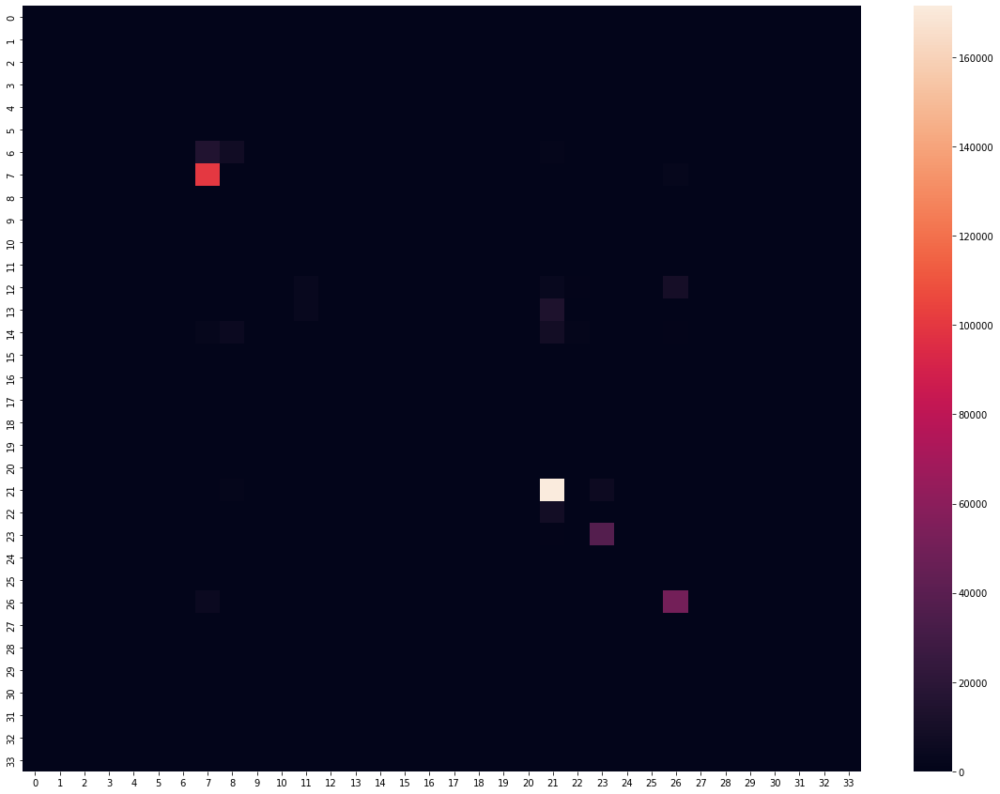

FCN-32 Test Results
********************
Mean IoU : 0.243445
*************************
Pixel-level IoU per class - 
*************************
         iou
0        NaN
1        NaN
2        NaN
3        NaN
4        NaN
5        NaN
6   0.000000
7   0.791844
8   0.000000
9        NaN
10       NaN
11  0.000000
12  0.000000
13  0.000000
14  0.000000
15       NaN
16       NaN
17       NaN
18       NaN
19       NaN
20       NaN
21  0.792805
22  0.000000
23  0.855481
24  0.000000
25       NaN
26  0.724660
27  0.000000
28       NaN
29       NaN
30       NaN
31       NaN
32       NaN
33       NaN


In [52]:
fig = plt.figure(figsize = (20, 15))
sns.heatmap(confus_mat, annot=False, fmt='.1f')
plt.show()
print("FCN-32 Test Results")
print("*"*20)
df_iou, mIoU = eval_metrics(confus_mat)
print("Mean IoU : {:.6f}".format(mIoU))
print("*"*25)
print("Pixel-level IoU per class - ")
print("*"*25)
print(df_iou)

In [98]:
resnet18_pretrained = models.resnet18(pretrained=True)
resnet18_pretrained.conv1.padding = (100, 100)
model_loaded_fcn16 = FCN16(resnet18_pretrained)
#model_loaded_fcn16 = FCN16(resnet18)  
model_loaded_fcn16 = model_loaded_fcn16.cpu()
model_loaded_fcn16.load_state_dict(torch.load('/content/drive/MyDrive/CV/saved_models/model_FCN16.pt'))
confus_mat = compute_confusion_matrix(model_loaded_fcn16, test_loader)

100%|██████████| 30/30 [00:46<00:00,  1.57s/it]


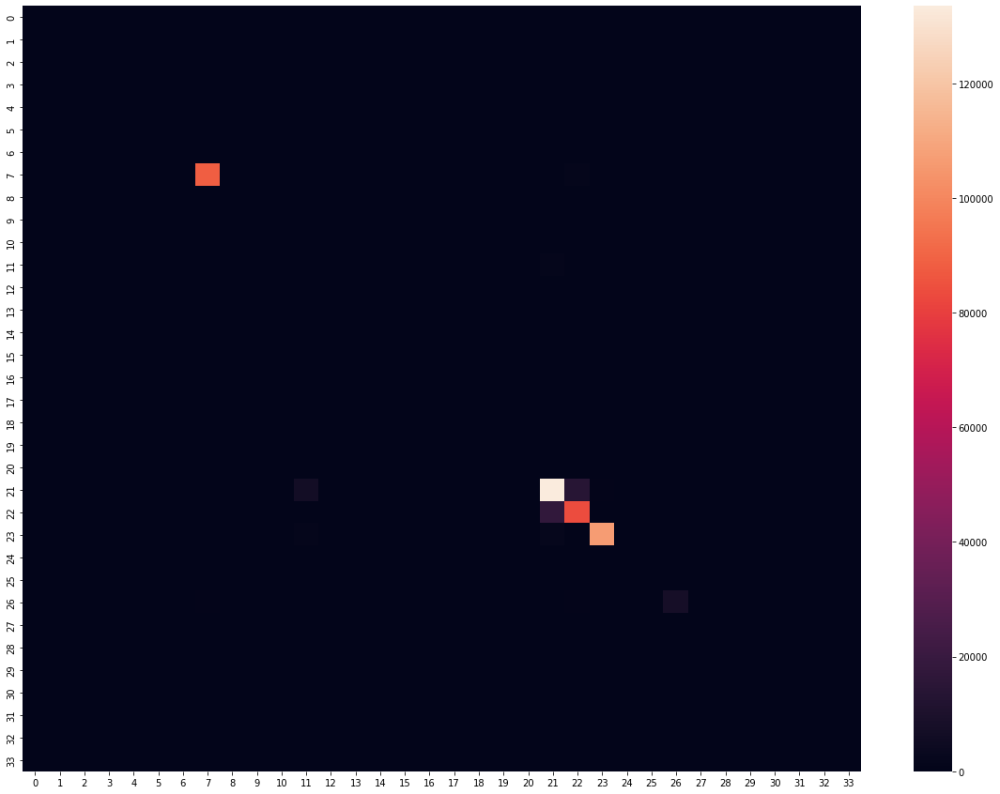

FCN-16 Test Results
******************************
Mean IoU : 0.418481
******************************
Pixel-level IoU per class - 
******************************
         iou
0        NaN
1        NaN
2        NaN
3        NaN
4   0.000000
5        NaN
6        NaN
7   0.973997
8   0.000000
9        NaN
10       NaN
11  0.000000
12       NaN
13       NaN
14  0.000000
15       NaN
16       NaN
17  0.000000
18       NaN
19       NaN
20       NaN
21  0.759901
22  0.711039
23  0.967128
24       NaN
25       NaN
26  0.772742
27       NaN
28       NaN
29       NaN
30       NaN
31       NaN
32       NaN
33       NaN


In [99]:
fig = plt.figure(figsize = (20, 15))
sns.heatmap(confus_mat, annot=False, fmt='.1f')
plt.show()
print("FCN-16 Test Results")
print("*"*30)
df_iou, mIoU = eval_metrics(confus_mat)
print("Mean IoU : {:.6f}".format(mIoU))
print("*"*30)
print("Pixel-level IoU per class - ")
print("*"*30)
print(df_iou)

In [39]:
def recolor_segmap(img, label_color_dict):
    
    r = np.zeros_like(img, dtype=np.uint8)
    g = np.zeros_like(img, dtype=np.uint8)
    b = np.zeros_like(img, dtype=np.uint8)
    
    for cat in label_color_dict.keys():
        idxs = img == cat
        r[idxs] = label_color_dict[cat][0]
        g[idxs] = label_color_dict[cat][1]
        b[idxs] = label_color_dict[cat][2]
        
    rgb = np.stack([r, g, b], axis=2)
    return rgb


In [40]:
Label = namedtuple( 'Label' , [
    'name', 'id',  'trainId', 'category', 'categoryId', 'hasInstances', 'ignoreInEval', 'color' ,] )
#--------------------------------------------------------------------------------
# A list of all labels
#--------------------------------------------------------------------------------

# Please adapt the train IDs as appropriate for you approach.
# Note that you might want to ignore labels with ID 255 during training.
# Further note that the current train IDs are only a suggestion. You can use whatever you like.
# Make sure to provide your results using the original IDs and not the training IDs.
# Note that many IDs are ignored in evaluation and thus you never need to predict these!

labels = [
    #       name                     id    trainId   category            catId     hasInstances   ignoreInEval   color
    Label(  'unlabeled'            ,  0 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'ego vehicle'          ,  1 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'rectification border' ,  2 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'out of roi'           ,  3 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'static'               ,  4 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'dynamic'              ,  5 ,      255 , 'void'            , 0       , False        , True         , (111, 74,  0) ),
    Label(  'ground'               ,  6 ,      255 , 'void'            , 0       , False        , True         , ( 81,  0, 81) ),
    Label(  'road'                 ,  7 ,        0 , 'flat'            , 1       , False        , False        , (128, 64,128) ),
    Label(  'sidewalk'             ,  8 ,        1 , 'flat'            , 1       , False        , False        , (244, 35,232) ),
    Label(  'parking'              ,  9 ,      255 , 'flat'            , 1       , False        , True         , (250,170,160) ),
    Label(  'rail track'           , 10 ,      255 , 'flat'            , 1       , False        , True         , (230,150,140) ),
    Label(  'building'             , 11 ,        2 , 'construction'    , 2       , False        , False        , ( 70, 70, 70) ),
    Label(  'wall'                 , 12 ,        3 , 'construction'    , 2       , False        , False        , (102,102,156) ),
    Label(  'fence'                , 13 ,        4 , 'construction'    , 2       , False        , False        , (190,153,153) ),
    Label(  'guard rail'           , 14 ,      255 , 'construction'    , 2       , False        , True         , (180,165,180) ),
    Label(  'bridge'               , 15 ,      255 , 'construction'    , 2       , False        , True         , (150,100,100) ),
    Label(  'tunnel'               , 16 ,      255 , 'construction'    , 2       , False        , True         , (150,120, 90) ),
    Label(  'pole'                 , 17 ,        5 , 'object'          , 3       , False        , False        , (153,153,153) ),
    Label(  'polegroup'            , 18 ,      255 , 'object'          , 3       , False        , True         , (153,153,153) ),
    Label(  'traffic light'        , 19 ,        6 , 'object'          , 3       , False        , False        , (250,170, 30) ),
    Label(  'traffic sign'         , 20 ,        7 , 'object'          , 3       , False        , False        , (220,220,  0) ),
    Label(  'vegetation'           , 21 ,        8 , 'nature'          , 4       , False        , False        , (107,142, 35) ),
    Label(  'terrain'              , 22 ,        9 , 'nature'          , 4       , False        , False        , (152,251,152) ),
    Label(  'sky'                  , 23 ,       10 , 'sky'             , 5       , False        , False        , ( 70,130,180) ),
    Label(  'person'               , 24 ,       11 , 'human'           , 6       , True         , False        , (220, 20, 60) ),
    Label(  'rider'                , 25 ,       12 , 'human'           , 6       , True         , False        , (255,  0,  0) ),
    Label(  'car'                  , 26 ,       13 , 'vehicle'         , 7       , True         , False        , (  0,  0,142) ),
    Label(  'truck'                , 27 ,       14 , 'vehicle'         , 7       , True         , False        , (  0,  0, 70) ),
    Label(  'bus'                  , 28 ,       15 , 'vehicle'         , 7       , True         , False        , (  0, 60,100) ),
    Label(  'caravan'              , 29 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0, 90) ),
    Label(  'trailer'              , 30 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0,110) ),
    Label(  'train'                , 31 ,       16 , 'vehicle'         , 7       , True         , False        , (  0, 80,100) ),
    Label(  'motorcycle'           , 32 ,       17 , 'vehicle'         , 7       , True         , False        , (  0,  0,230) ),
    Label(  'bicycle'              , 33 ,       18 , 'vehicle'         , 7       , True         , False        , (119, 11, 32) ),
]

In [41]:
class_to_color = {}
for label in labels:
    class_to_color[label.id] = label.color

In [42]:
def visualize(net, test_loader, class_to_color):
    
    net = net.cpu()
    # Evaluation mode
    net.eval()
    with torch.set_grad_enabled(False):
        for i, (features, labels) in enumerate(test_loader):
            
            outputs = net(features)
            
            # Calculate prediction of classes by net
            _, preds = outputs.max(1)
            
            features, true_mask, pred_mask = features.squeeze(0), labels.squeeze(0), preds.squeeze(0)
            features = features.permute(1, 2, 0)
            
            pred_segmap = recolor_segmap(pred_mask, class_to_color)
            true_segmap = recolor_segmap(true_mask, class_to_color)
            
            plot_output(pred_segmap,true_segmap)

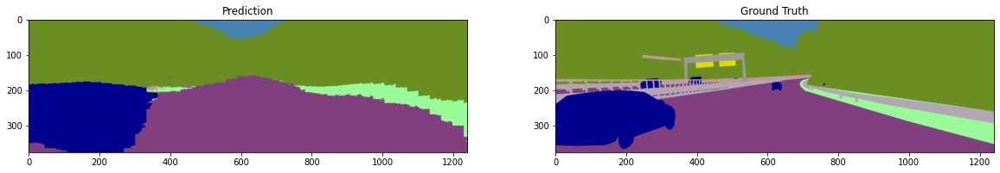

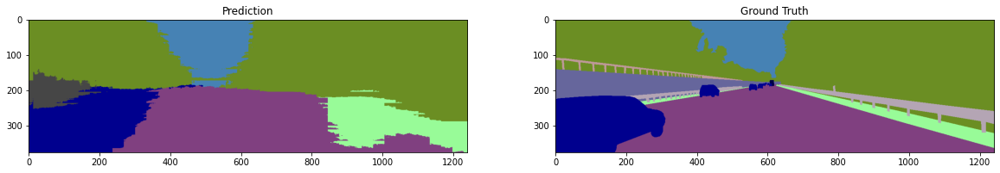

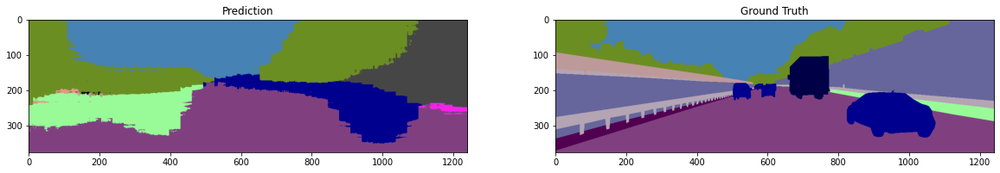

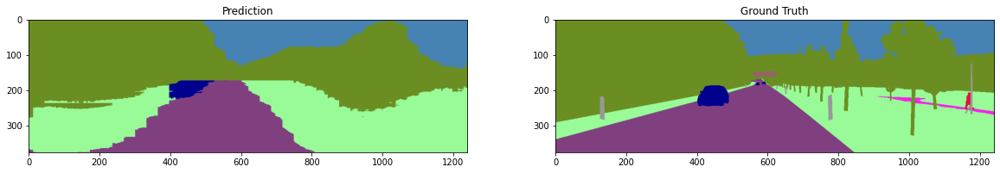

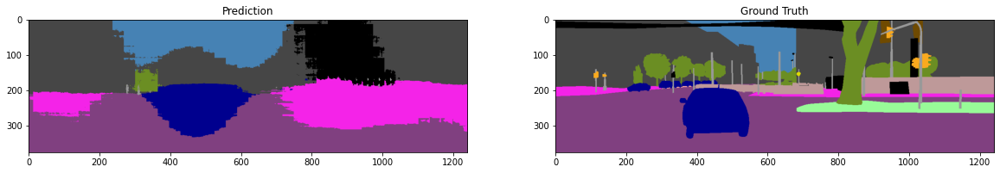

...

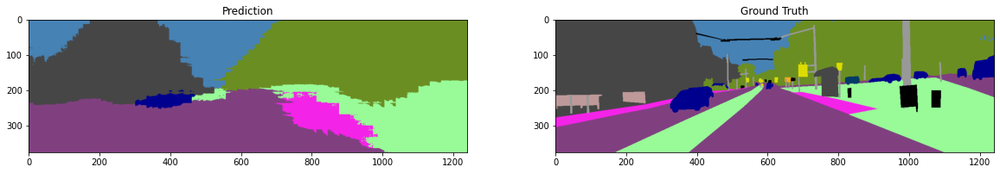

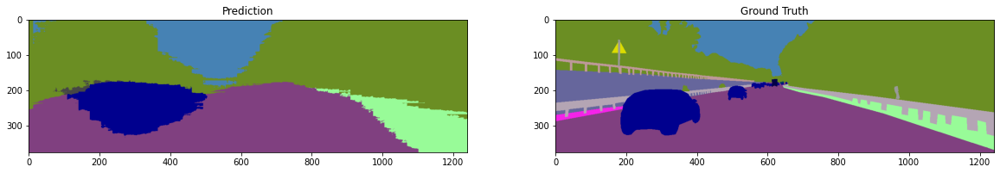

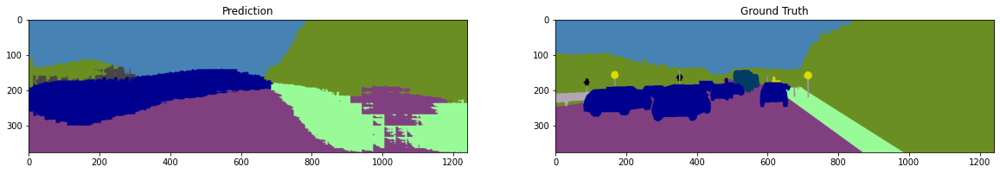

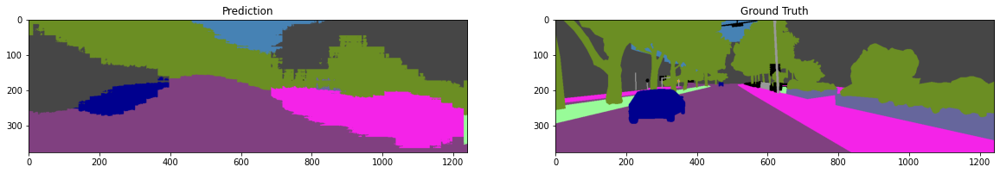

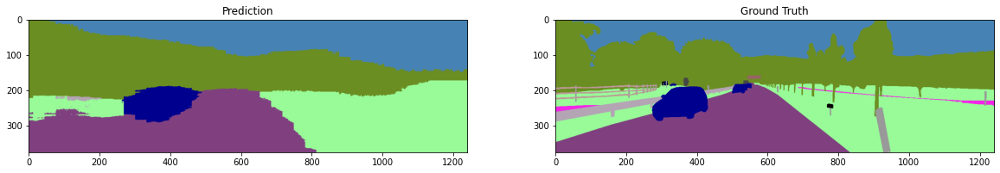

In [63]:
visualize(model_loaded_FCN32,test_loader,class_to_color)

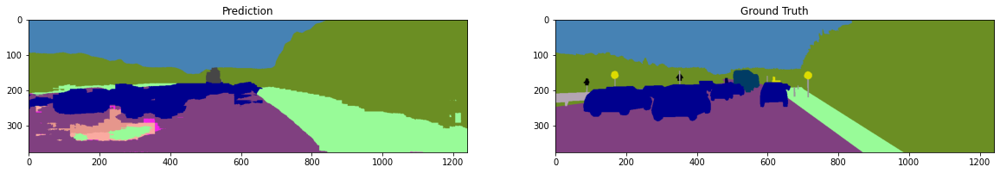

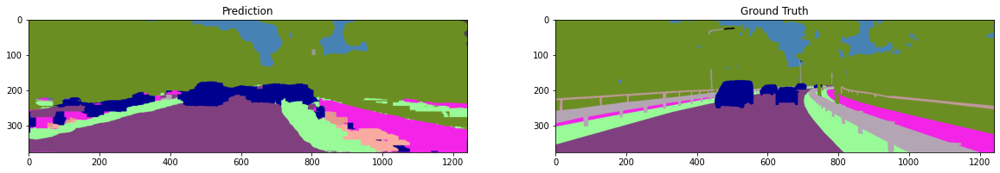

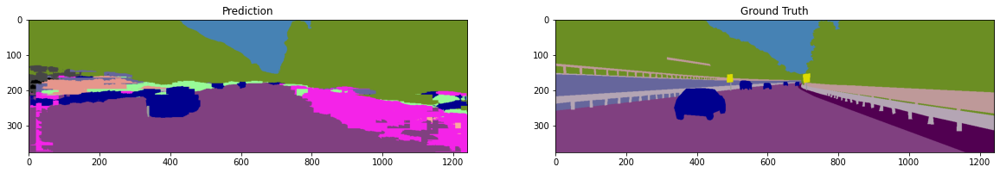

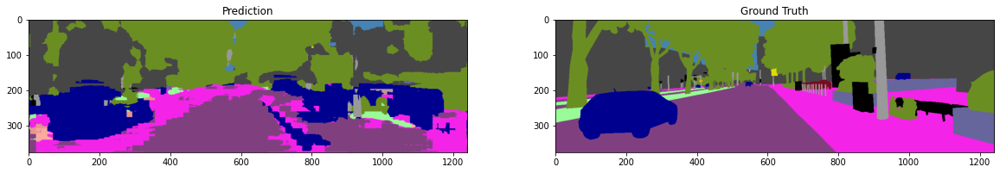

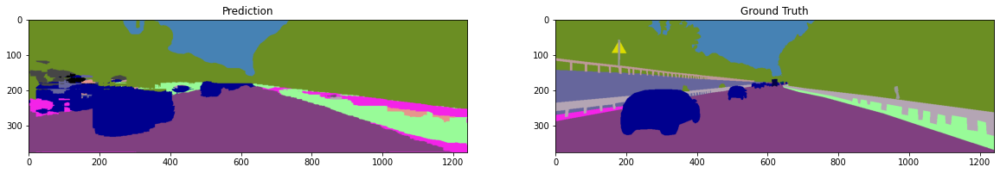

...

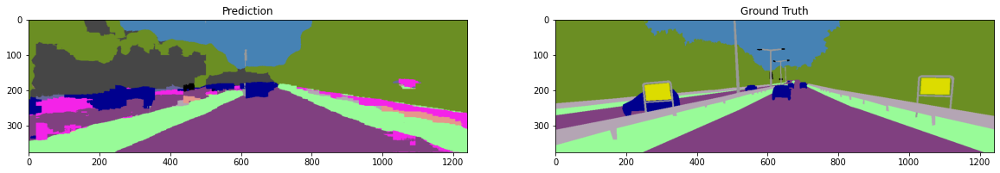

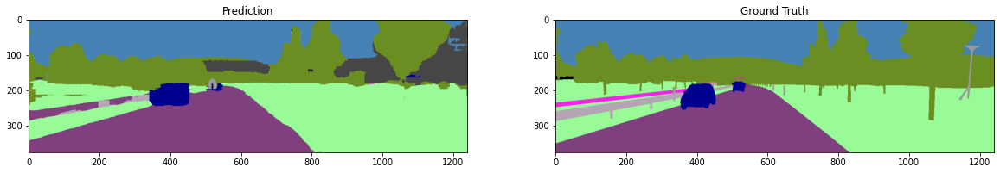

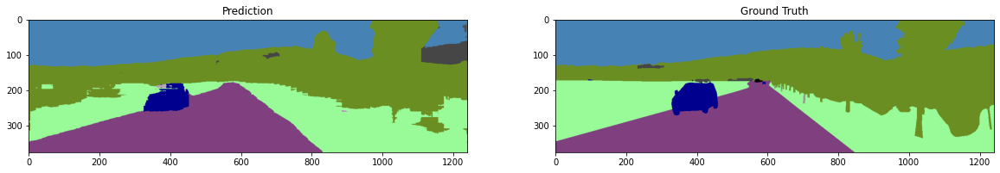

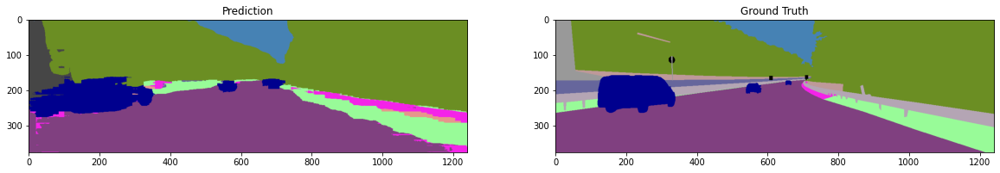

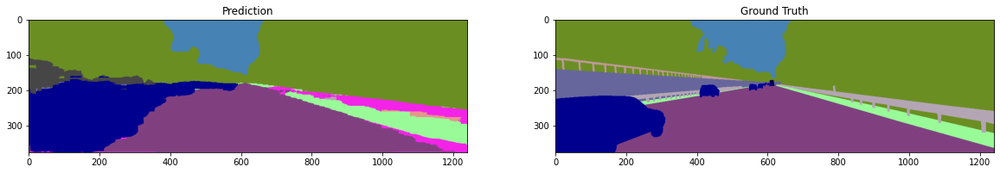

In [95]:
visualize(model_loaded_fcn16,test_loader,class_to_color)